In [1]:
import os
import math
import random
import shutil
import imghdr
import numpy as np
import concurrent.futures
import matplotlib.pyplot as plt

from tqdm import tqdm
from PIL import Image
from collections import defaultdict

In [2]:
def has_transparent_pixels(file_path):
    with Image.open(file_path) as img:
        if img.mode in ('RGBA', 'LA') or (img.mode == 'P' and 'transparency' in img.info):
            img = img.convert('RGBA')
            datas = img.getdata()
            for item in datas:
                if item[3] < 255:
                    return True
    return False

def is_image(file_path):
    try:
        Image.open(file_path).verify()
        return True
    except:
        return False

def get_image_resolution(file_path):
    with Image.open(file_path) as img:
        return img.size
    
def add_extension_if_missing(file_path):
    if not os.path.splitext(file_path)[1]:
        image_type = imghdr.what(file_path)
        if image_type:
            new_file_path = f"{file_path}.{image_type}"
            os.rename(file_path, new_file_path)
            return new_file_path
    return file_path
    
def extract_domain(file_path):
    # parts = file_path.split(os.sep)
    # if len(parts) > 1:
    #     return parts[-2]
    # return "unknown"
    parts = file_path.split("\\")[-1].split('_')[0]
    return parts

def load_and_resize_image(image_path, max_size):
    img = Image.open(image_path)
    img.thumbnail((max_size, max_size), Image.LANCZOS)
    return img

def create_collage(input_dir, output_image=None, images_per_row=5, max_size=250):
    image_paths = [os.path.join(input_dir, img) for img in os.listdir(input_dir) if img.lower().endswith(('png', 'jpg', 'jpeg', 'bmp', 'gif', 'webp'))]
    
    if len(image_paths) == 0:
        print("No images found in the directory.")
        return None
    
    with concurrent.futures.ThreadPoolExecutor() as executor:
        images = list(executor.map(load_and_resize_image, image_paths, [max_size]*len(image_paths)))
    
    num_images = len(images)
    images_per_row = min(images_per_row, num_images)
    num_rows = math.ceil(num_images / images_per_row)
    
    collage_width = images_per_row * max_size
    collage_height = num_rows * max_size
    collage_image = Image.new('RGB', (collage_width, collage_height))
    
    for idx, img in enumerate(images):
        row = idx // images_per_row
        col = idx % images_per_row
        x = col * max_size
        y = row * max_size
        x_offset = (max_size - img.size[0]) // 2
        y_offset = (max_size - img.size[1]) // 2
        collage_image.paste(img, (x + x_offset, y + y_offset))
    
    if output_image is not None:
        collage_image.save(output_image)
        print(f"Collage saved as {output_image}")
    
    return collage_image

## 0. List All Domains in Data

In [3]:
images_folder_path = 'images'
# images_folder_path = 'JUN21_stratified512x256'
directories = [d for d in os.listdir(images_folder_path) if os.path.isdir(os.path.join(images_folder_path, d))]
print('\n'.join(directories))
# print('\n'.join(random.sample(directories, len(directories))))

91club.club
91club06.com
9animetv.to
account.samsung.com
alexisbima.com
ameblo.jp
aniwatchtv.to
app.hubspot.com
apps.facebook.com
ar.m.wikipedia.org
articulo.mercadolibre.com.ar
articulo.mercadolibre.com.mx
as.com
asuratoon.com
auctions.yahoo.co.jp
auto.drom.ru
bakusai.com
baseball.yahoo.co.jp
bato.to
battwo.com
bbs.ruliweb.com
bdvenlinea.banvenez.com
beauty.hotpepper.jp
bebesong.com
becasprogresar.educacion.gob.ar
betinexchange.com
blog.livedoor.jp
bollyflix.cash
bpexch.com
br.betano.com
br.pinterest.com
brainly.co.id
brainly.com.br
brainly.in
business.facebook.com
business.google.com
byjus.com
calendar.google.com
cardgames.io
cfspart.impots.gouv.fr
chance.enjoy.point.auone.jp
character.ai
chromewebstore.google.com
classroom.google.com
clever.com
coinmarketcap.com
context.reverso.net
cookpad.com
d000d.com
dantri.com.vn
de.m.wikipedia.org
detail.chiebukuro.yahoo.co.jp
direct.lc.chat
discord.com
divar.ir
dmarket.docomo.ne.jp
doujindesu.tv
dpboss.services
drive.google.com
dto.to
duckduck

## 1. Cleaning the Data
- The following code will remove any empty directories (webpages with no images)
- Please manually inspect and remove any unwanted content (e.g. adult websites)

In [110]:
def move_empty_directories(source_dir, dest_dir):
    if not os.path.exists(dest_dir):
        os.makedirs(dest_dir)
    
    for root, dirs, files in os.walk(source_dir):
        for dir_name in dirs:
            dir_path = os.path.join(root, dir_name)
            if not os.listdir(dir_path):
                relative_path = os.path.relpath(dir_path, source_dir)
                dest_path = os.path.join(dest_dir, relative_path)
                os.makedirs(os.path.dirname(dest_path), exist_ok=True)
                shutil.move(dir_path, dest_path)
                print(f"Moved empty directory: {dir_path} to {dest_path}")

move_empty_directories("images", "empty_dir")

## 2. Create List of Paths for All Images

In [111]:
def collect_images(source_directory):
    all_images = []
    for root, dirs, files in tqdm(os.walk(source_directory), desc="Collecting images", unit="directory"):
        for file in files:
            file_path = os.path.join(root, file)
            file_path = add_extension_if_missing(file_path)
            if is_image(file_path) and not has_transparent_pixels(file_path) and os.path.splitext(file_path)[1].lower() in ['.jpg', '.jpeg', '.png', '.bmp', '.gif']:
                file_size = os.path.getsize(file_path)
                image_size = get_image_resolution(file_path)
                all_images.append((file_path, file_size, image_size))
    return all_images

all_images = collect_images("stratified_512x512_1")

## 3. Randomly Sample 500 Images from All Images

In [8]:
def sample_images_randomly(all_images, target_dir, num_samples, min_size=0, min_w=0, min_h=0):
    filtered_images = [image for image in all_images if image[1] >= min_size and image[2][0] >= min_w and image[2][1] >= min_h]

    if num_samples > len(filtered_images):
        raise ValueError(f"Requested number of samples ({num_samples}) exceeds the available images ({len(filtered_images)}).")
    
    sampled_images = random.sample(filtered_images, num_samples)
    
    original_target_dir = target_dir
    counter = 1
    while os.path.exists(target_dir):
        target_dir = f"{original_target_dir}_{counter}"
        counter += 1
    
    os.makedirs(target_dir)
    
    for idx, (image, _, _) in enumerate(tqdm(sampled_images, desc="Copying and renaming images", unit="image"), start=1):
        domain = extract_domain(image)
        new_name = f"{domain}_{idx:03d}{os.path.splitext(image)[1]}"
        shutil.copy(image, os.path.join(target_dir, new_name))
    
    return target_dir

Copying and renaming images: 100%|██████████| 500/500 [00:00<00:00, 2061.31image/s]
c:\Users\Danish\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:981: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


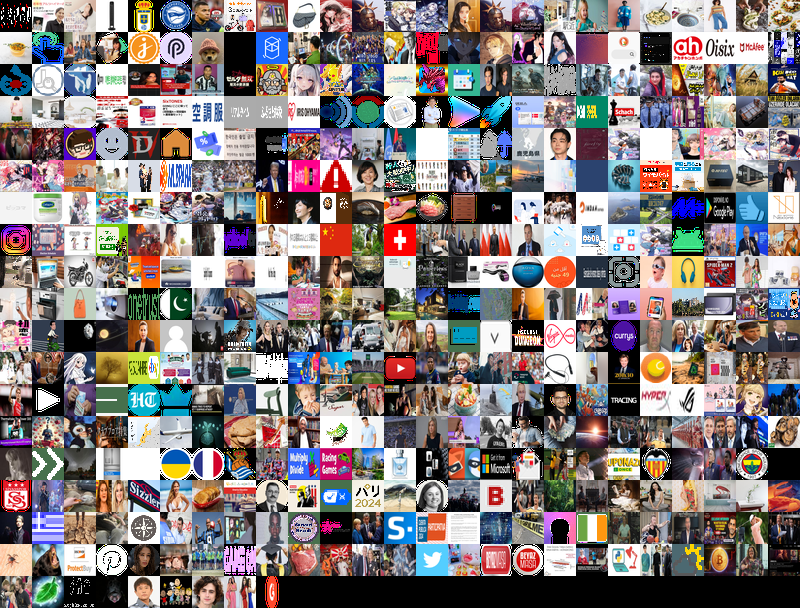

In [99]:
target = sample_images_randomly(all_images, "random_sampled_images", 500)
create_collage(target)

Copying and renaming images: 100%|██████████| 500/500 [00:00<00:00, 1292.74image/s]


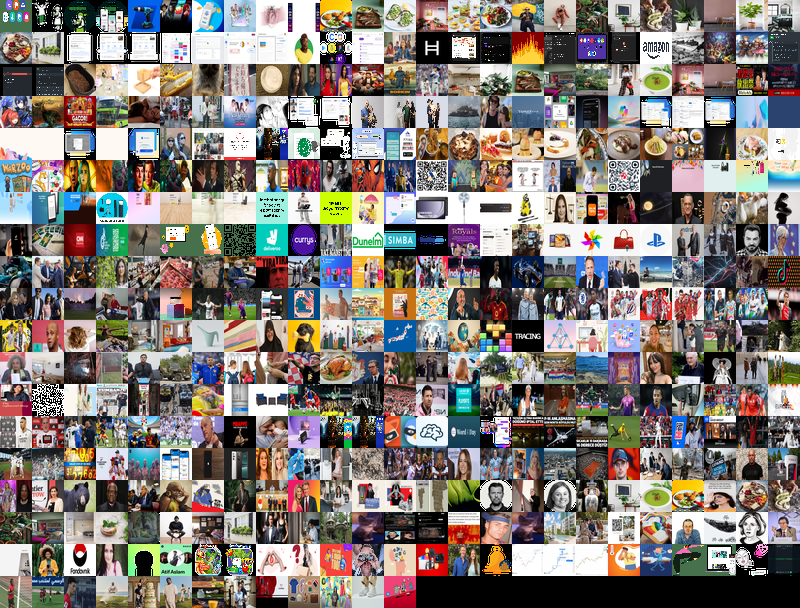

In [100]:
target = sample_images_randomly(all_images, "random_sampled_images_min512x512", 500, 0, 512, 512)
create_collage(target)

## 4. Randomly Sampled 500 Images by Selecting a Website First, then an Image

In [9]:
def sample_images_randomly_by_domain(all_images, target_dir, num_samples, min_size=0, min_w=0, min_h=0):
    filtered_images = [image for image in all_images if image[1] >= min_size and ((image[2][0] >= min_w and image[2][1] >= min_h) or (image[2][0] >= min_h and image[2][1] >= min_w))]
    
    domain_dict = defaultdict(list)
    for image in filtered_images:
        domain = extract_domain(image[0])
        domain_dict[domain].append(image)
    
    sampled_images = set()  # Use a set to avoid duplicates
    sampled_domains = []

    while len(sampled_images) < num_samples:
        domain = random.choice(list(domain_dict.keys()))
        if len(domain_dict[domain]) == 0:
            continue
        sampled_image = random.choice(domain_dict[domain])
        domain_dict[domain].remove(sampled_image)
        sampled_images.add(sampled_image)
        sampled_domains.append(domain)
    
    sampled_images = list(sampled_images)

    original_target_dir = target_dir
    counter = 1
    while os.path.exists(target_dir):
        target_dir = f"{original_target_dir}_{counter}"
        counter += 1
    
    os.makedirs(target_dir)
    
    for idx, (image, _, _) in enumerate(tqdm(sampled_images, desc="Copying and renaming images", unit="image"), start=1):
        domain = extract_domain(image)
        new_name = f"{domain}_{idx:03d}{os.path.splitext(image)[1]}"
        shutil.copy(image, os.path.join(target_dir, new_name))

    return target_dir

Copying and renaming images: 100%|██████████| 500/500 [00:00<00:00, 1619.99image/s]


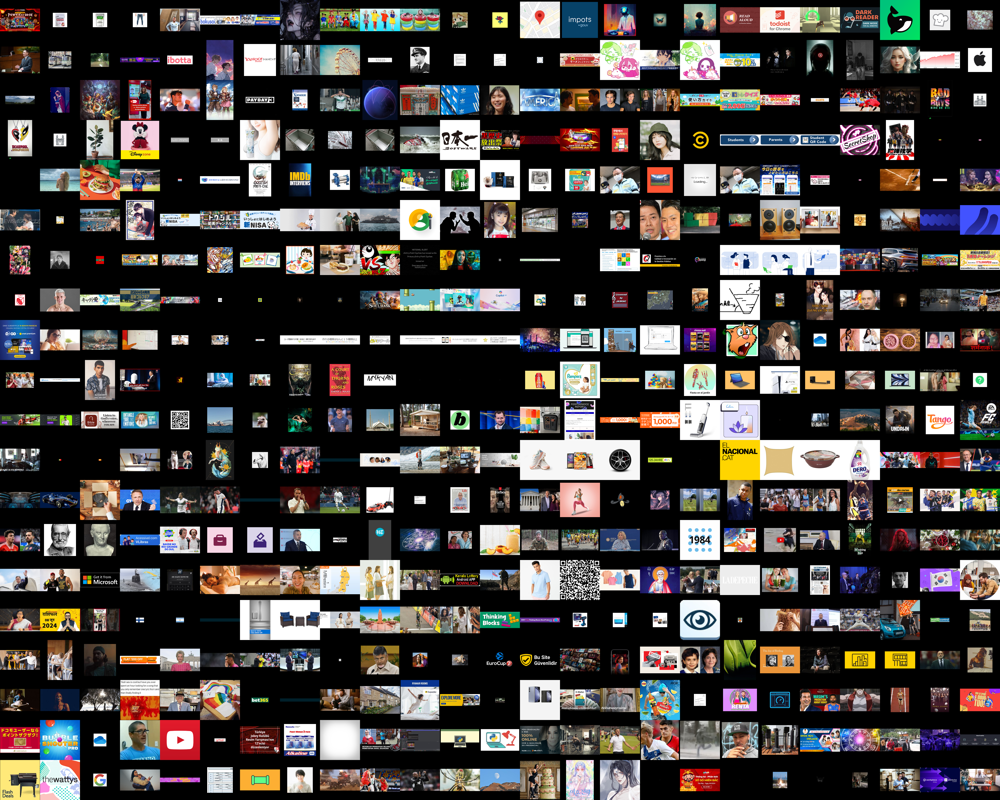

In [235]:
target = sample_images_randomly_by_domain(all_images, "random_sampled_images_by_domain", 512, 512)
create_collage(target, None, 25)

## 5. Randomly Sampled 500 Images Stratified by Domain

1. E commerce (online shops)
2. Information/Educational (wikipedia, etc)
3. Business (company website)
4. News (bbc, cnn, etc)
5. Social Media (reddit, etc)
6. Video streaming (youtube, etc)r
7. Other (everything that cannot be classified into the above)

In [4]:
from_screenshots = {
    "app.hubspot.com": 7,
    "apps.facebook.com": 5,
    "91club.club": 7,
    "91club06.com": 7,
    "ar.m.wikipedia.org": 2,
    "9animetv.to": 6,
    "aniwatchtv.to": 6,
    "account.samsung.com": 3,
    "as.com": 4,
    "ameblo.jp": 7,
    "articulo.mercadolibre.com.ar": 1,
    "articulo.mercadolibre.com.mx": 1,
    "auto.drom.ru": 1,
    "bakusai.com": 7,
    "baseball.yahoo.co.jp": 4,
    "battwo.com": 7,
    "bato.to": 7,
    "bdvenlinea.banvenez.com": 7,
    "auctions.yahoo.co.jp": 1,
    "becasprogresar.educacion.gob.ar": 2,
    "blog.livedoor.jp": 7,
    "asuratoon.com": 7,
    "alexisbima.com": 7,
    "bpexch.com": 7,
    "betinexchange.com": 7,
    "br.betano.com": 7,
    "br.pinterest.com": 5,
    "bebesong.com": 7,
    "brainly.co.id": 2,
    "brainly.com.br": 2,
    "beauty.hotpepper.jp": 3,
    "brainly.in": 2,
    "business.google.com": 3,
    "business.facebook.com": 3,
    "cardgames.io": 7,
    "cfspart.impots.gouv.fr": 7,
    "byjus.com": 2,
    "chance.enjoy.point.auone.jp": 7,
    "bbs.ruliweb.com": 7,
    "cookpad.com": 2,
    "coinmarketcap.com": 3,
    "calendar.google.com": 7,
    "context.reverso.net": 2,
    "chromewebstore.google.com": 1,
    "classroom.google.com": 2,
    "clever.com": 2,
    "d000d.com": 7,
    "de.m.wikipedia.org": 2,
    "detail.chiebukuro.yahoo.co.jp": 7,
    "direct.lc.chat": 3,
    "duckduckgo.com": 7,
    "dmarket.docomo.ne.jp": 1,
    "divar.ir": 7,
    "dto.to": 7,
    "dpboss.services": 7,
    "dantri.com.vn": 4,
    "drive.google.com": 7,
    "en.wikipedia.org": 2,
    "dzen.ru": 4,
    "email.seznam.cz": 7,
    "emaktab.uz": 2,
    "elpais.com": 4,
    "es.m.wikipedia.org": 2,
    "ecnavi.jp": 7,
    "fa.m.wikipedia.org": 2,
    "esaj.tjsp.jus.br": 7,
    "es.aliexpress.com": 1,
    "faq.whatsapp.com": 2,
    "es.scribd.com": 2,
    "finance.naver.com": 3,
    "ficbook.net": 7,
    "finance.yahoo.co.jp": 4,
    "fr.m.wikipedia.org": 2,
    "free.facebook.com": 5,
    "funpay.com": 7,
    "fantia.jp": 7,
    "finance.yahoo.com": 4,
    "game.granbluefantasy.jp": 7,
    "gdz.ru": 2,
    "game8.jp": 3,
    "gall.dcinside.com": 7,
    "gemini.google.com": 3,
    "ge.globo.com": 4,
    "gamewith.jp": 7,
    "giris.turkiye.gov.tr": 7,
    "github.com": 3,
    "g1.globo.com": 4,
    "en.luxuretv.com": 7,
    "hdhub4u.rsvp": 7,
    "genius.com": 3,
    "harimanga.com": 7,
    "hianime.to": 6,
    "gshow.globo.com": 7,
    "id.m.wikipedia.org": 2,
    "homepage.vivo.com": 7,
    "hiroba.dpoint.docomo.ne.jp": 7,
    "in.pinterest.com": 5,
    "ifilo.net": 7,
    "imgsrc.ru": 7,
    "grapee.jp": 7,
    "it.m.wikipedia.org": 2,
    "ja.wikipedia.org": 2,
    "ja.m.wikipedia.org": 2,
    "in.bookmyshow.com": 3,
    "heylink.me": 7,
    "item.rakuten.co.jp": 1,
    "komikindo.tv": 7,
    "kkstories.com": 7,
    "kompoz2.com": 7,
    "laser247.online": 7,
    "khoahoc.vietjack.com": 2,
    "lichess.org": 7,
    "launchpad.classlink.com": 2,
    "linktr.ee": 7,
    "koiantitebas.com": 7,
    "kakuyomu.jp": 2,
    "link.coupang.com": 1,
    "lms.lausd.net": 2,
    "hochi.news": 4,
    "litnet.com": 7,
    "login.yahoo.com": 7,
    "m.autoplius.lt": 7,
    "m.animeflv.net": 7,
    "m.999.md": 7,
    "m.cricbuzz.com": 3,
    "letterboxd.com": 5,
    "m.daum.net": 4,
    "m.bild.de": 4,
    "m.facebook.com": 5,
    "m.cafe.daum.net": 5,
    "m.fanfiction.net": 7,
    "m.humoruniv.com": 7,
    "m.kooora.com": 4,
    "m.indiamart.com": 1,
    "m.gsmarena.com": 4,
    "m.fmkorea.com": 7,
    "m.imdb.com": 7,
    "m.haber7.com": 4,
    "m.naver.com": 7,
    "m.ok.ru": 5,
    "m.inven.co.kr": 7,
    "m.avito.ru": 1,
    "m.olx.pl": 7,
    "m.search.naver.com": 7,
    "m.skelbiu.lt": 7,
    "m.shein.com": 1,
    "m.sports.naver.com": 7,
    "m.ss.com": 7,
    "m.vk.com": 5,
    "m.ppomppu.co.kr": 7,
    "m.vidio.com": 6,
    "m.tabor.ru": 7,
    "m.ruliweb.com": 7,
    "m.magazineluiza.com.br": 1,
    "mail.ru": 7,
    "m.yahoo.co.jp": 4,
    "mangatoto.com": 7,
    "mechacomic.jp": 1,
    "mangabuddy.com": 7,
    "missav.com": 7,
    "m.site777.jp": 7,
    "mpokec.azet.sk": 5,
    "m.tribunnews.com": 4,
    "meet.google.com": 7,
    "music-fa.com": 7,
    "member.sss.gov.ph": 7,
    "mlbpark.donga.com": 7,
    "manhwaclan.com": 7,
    "myaccount.google.com": 7,
    "myactivity.google.com": 7,
    "mail.yahoo.com": 7,
    "n.news.naver.com": 4,
    "myapps.classlink.com": 3,
    "myanimelist.net": 7,
    "news.google.com": 4,
    "news.livedoor.com": 4,
    "news.yahoo.co.jp": 4,
    "newtoki332.com": 7,
    "newtoki334.com": 7,
    "nouen.sp.mbga.jp": 7,
    "news.infoseek.co.jp": 4,
    "news.goo.ne.jp": 4,
    "newtoki333.com": 7,
    "olxmewah.com": 7,
    "newtoki335.com": 7,
    "one.google.com": 3,
    "old.reddit.com": 5,
    "onedrive.live.com": 3,
    "people.com": 4,
    "ncode.syosetu.com": 7,
    "pl.m.wikipedia.org": 2,
    "play.blooket.com": 7,
    "photos.google.com": 7,
    "page.auctions.yahoo.co.jp": 1,
    "nypost.com": 4,
    "pikabu.ru": 5,
    "open.spotify.com": 7,
    "poop.com.co": 7,
    "poczta.wp.pl": 7,
    "pet.gree-apps.net": 7,
    "produto.mercadolivre.com.br": 1,
    "play.google.com": 1,
    "pt.m.wikipedia.org": 2,
    "pubmed.ncbi.nlm.nih.gov": 2,
    "portal.auone.jp": 4,
    "quizlet.com": 2,
    "quillbot.com": 3,
    "retail.onlinesbi.sbi": 3,
    "readmanga.live": 7,
    "railapp.railway.gov.bd": 7,
    "rx.sp.mbga.jp": -1,
    "s.mogg.ameba.jp": 7,
    "rezka.ag": 6,
    "ru.m.wikipedia.org": 2,
    "outlook.live.com": 7,
    "saednews.com": 4,
    "satta-king-fixed-no.in": 7,
    "sattamatkano1.me": 7,
    "scholar.google.com": 2,
    "scratch.mit.edu": 2,
    "piccoma.com": 7,
    "s.tabelog.com": 7,
    "race.sp.netkeiba.com": 7,
    "sattaamatka.co.com": 7,
    "sattasport.in": 7,
    "search.yahoo.com": 7,
    "screenrant.com": 4,
    "search.rakuten.co.jp": 1,
    "sede.agenciatributaria.gob.es": 3,
    "secure.livechatinc.com": 3,
    "serviziweb2.inps.it": 7,
    "sellercentral.amazon.com": 3,
    "ser.brstej.com": 6,
    "shopee.com.br": 1,
    "secure.bankofamerica.com": 3,
    "select.mamastar.jp": 2,
    "shopee.co.id": 1,
    "shootz.yalla-shoot-tv.live": 7,
    "spboss.blog": 7,
    "sportowefakty.wp.pl": 4,
    "srd.sassa.gov.za": 3,
    "smt.docomo.ne.jp": 4,
    "sp.mbga.jp": 7,
    "steamcommunity.com": 7,
    "sso.acesso.gov.br": 7,
    "store.steampowered.com": 1,
    "sports.yahoo.co.jp": 4,
    "studio.code.org": 2,
    "support.google.com": 2,
    "ssstik.io": 7,
    "suumo.jp": 7,
    "support.microsoft.com": 3,
    "transit.yahoo.co.jp": 7,
    "translate.google.com": 7,
    "topics.smt.docomo.ne.jp": 4,
    "tools.usps.com": 3,
    "tamilyogi.beer": 7,
    "timesofindia.indiatimes.com": 4,
    "truyenfull.vn": 7,
    "tsn.ua": 4,
    "tv3.simontokx.online": 7,
    "tv1.simontokx.online": 7,
    "syosetu.org": 7,
    "trilltrill.jp": 7,
    "tvn24.pl": 4,
    "turbo.az": 1,
    "togetter.com": 7,
    "sp.oddspark.com": 7,
    "uk.indeed.com": 7,
    "uchi.ru": 2,
    "upmsp.edu.in": 2,
    "udn.com": 4,
    "ua.sinoptik.ua": 7,
    "v22-ispdy5ersd-ai-verify--gcs.g-xyz.xyz": 7,
    "tw.news.yahoo.com": 4,
    "unifiedportal-mem.epfindia.gov.in": 3,
    "tw.stock.yahoo.com": 4,
    "uranai.nosv.org": 7,
    "web.facebook.com": 5,
    "tw.yahoo.com": 4,
    "tenki.jp": 2,
    "web.spaggiari.eu": 2,
    "wiadomosci.onet.pl": 4,
    "web.whatsapp.com": 5,
    "visortmo.com": 7,
    "wordwall.net": 2,
    "wiadomosci.wp.pl": 4,
    "www.20minutos.es": 4,
    "www.1024tera.com": 3,
    "vnexpress.net": 4,
    "www.action.com": 1,
    "www.ad.nl": 4,
    "www.agoda.com": 1,
    "weather.com": 2,
    "www.ajio.com": 1,
    "www.aajtak.in": 4,
    "www.24h.com.vn": 4,
    "www.amazon.ca": 1,
    "www.almasryalyoum.com": 4,
    "www.accuweather.com": 2,
    "www.amazon.com": 1,
    "www.aliexpress.com": 1,
    "www.amazon.co.uk": 1,
    "www.amazon.com.br": 1,
    "www.amazon.de": 1,
    "www.amazon.com.mx": 1,
    "www.amazon.eg": 1,
    "www.amazon.es": 1,
    "www.amazon.it": 1,
    "www.amazon.fr": 1,
    "www.amazon.in": 1,
    "www.ancestry.com": 3,
    "www.aparat.com": 6,
    "www.arbada.com": 7,
    "www.asos.com": 1,
    "www.baidu.com": 7,
    "www.bbc.com": 4,
    "www.betpawa.ug": 7,
    "www.bbc.co.uk": 4,
    "www.bilibili.com": 6,
    "www.amarujala.com": 4,
    "www.bing.com": 7,
    "www.bilibili.tv": 6,
    "www.bol.com": 1,
    "www.bpexch.com": 7,
    "www.booking.com": 7,
    "www.avito.ru": 1,
    "www.blic.rs": 4,
    "www.bt.dk": 4,
    "www.canva.com": 7,
    "www.boatrace.jp": 7,
    "www.buzzfeed.com": 4,
    "www.clarin.com": 4,
    "www.amazon.co.jp": 1,
    "www.biblegateway.com": 2,
    "www.carsensor.net": 1,
    "www.chegg.com": 2,
    "www.cnbcindonesia.com": 4,
    "www.cnnbrasil.com.br": 4,
    "www.cmoa.jp": 1,
    "www.cnn.com": 4,
    "www.coco.gg": 7,
    "www.coolmathgames.com": 7,
    "www.conectate.com.do": 7,
    "www.codashop.com": 1,
    "www.cnnindonesia.com": 4,
    "www.creditkarma.com": 3,
    "www.credit-agricole.fr": 3,
    "www.corriere.it": 4,
    "www.dagbladet.no": 4,
    "www.dailymotion.com": 6,
    "www.cronista.com": 4,
    "www.cricbuzz.com": 4,
    "www.dafont.com": 7,
    "www.digikala.com": 1,
    "www.deviantart.com": 7,
    "www.dropbox.com": 3,
    "www.diretta.it": 7,
    "www.disneyplus.com": 6,
    "www.dailymail.co.uk": 4,
    "www.ebay.co.uk": 1,
    "www.ebay.com": 1,
    "www.ecosia.org": 7,
    "www.ebay.de": 1,
    "www.curseforge.com": 7,
    "www.ebay.it": 1,
    "www.eltiempo.es": 7,
    "www.coingecko.com": 3,
    "www.emag.ro": 1,
    "www.expressen.se": 4,
    "www.etsy.com": 1,
    "www.excellenth5game.com": 7,
    "www.eenadu.net": 4,
    "www.betika.com": 7,
    "www.espncricinfo.com": 4,
    "www.espn.com": 4,
    "www.facebook.com": 5,
    "www.filmyzilla.lv": 7,
    "www.flashscore.com": 3,
    "www.fiverr.com": 3,
    "www.flashscore.com.br": 7,
    "www.flashscore.fr": 7,
    "www.flipkart.com": 1,
    "www.flashscore.pl": 7,
    "www.fanpage.it": 4,
    "www.francetvinfo.fr": 4,
    "www.fmkorea.com": 7,
    "www.freepik.com": 7,
    "www.gismeteo.ru": 2,
    "www.foxnews.com": 4,
    "www.gazzetta.it": 4,
    "www.forbes.com": 4,
    "www.furaffinity.net": 7,
    "www.google.ca": 7,
    "www.google.co.in": 7,
    "www.elmundo.es": 4,
    "www.globo.com": 4,
    "www.geny.com": 7,
    "www.google.co.jp": 7,
    "www.google.co.uk": 7,
    "www.google.com.mx": 7,
    "www.google.com.br": 7,
    "www.google.com": 7,
    "www.google.com.hk": 7,
    "www.google.com.tr": 7,
    "www.goodreads.com": 2,
    "www.google.de": 7,
    "www.goal.com": 4,
    "www.gov.uk": 3,
    "www.google.es": 7,
    "www.google.it": 7,
    "www.google.fr": 7,
    "www.google.pl": 7,
    "www.gov.br": 7,
    "www.hln.be": 4,
    "www.hibiny.ru": 4,
    "www.hindustantimes.com": 4,
    "www.ikea.com": 1,
    "www.idnes.cz": 4,
    "www.hurriyet.com.tr": 4,
    "www.indeed.com": 7,
    "www.iltalehti.fi": 4,
    "www.imdb.com": 7,
    "www.hltv.org": 7,
    "www.instagram.com": 5,
    "www.index.hr": 4,
    "www.istockphoto.com": 7,
    "www.interia.pl": 4,
    "www.infobae.com": 4,
    "www.ixbt.com": 4,
    "www.inven.co.kr": 7,
    "www.jiocinema.com": 6,
    "www.keralalotterytoday.com": 7,
    "www.kohls.com": 1,
    "www.elnacional.cat": 4,
    "www.jw.org": 2,
    "www.khabaronline.ir": 4,
    "www.kleinanzeigen.de": 1,
    "www.jalan.net": 1,
    "www.lemonde.fr": 4,
    "www.ladepeche.fr": 4,
    "www.haberler.com": 4,
    "www.lefigaro.fr": 4,
    "www.ilmeteo.it": 4,
    "www.leboncoin.fr": 1,
    "www.kurir.rs": 4,
    "www.linkedin.com": 5,
    "www.lanacion.com.ar": 4,
    "www.livescore.com": 7,
    "www.livehindustan.com": 4,
    "www.livescore.in": 7,
    "www.letras.mus.br": 7,
    "www.lxtgame.com": 7,
    "www.lowes.com": 1,
    "www.mathplayground.com": 2,
    "www.mediaexpert.pl": 1,
    "www.makemytrip.com": 7,
    "www.mercadolivre.com.br": 1,
    "www.mercadolibre.com.mx": 1,
    "www.marktplaats.nl": 1,
    "www.mayoclinic.org": 3,
    "www.mediafire.com": 7,
    "www.mercadolibre.com.ar": 1,
    "www.merkur.de": 4,
    "www.marca.com": 4,
    "www.messenger.com": 5,
    "www.microsoft.com": 3,
    "www.midilibre.fr": 4,
    "www.mobile.de": 1,
    "www.macys.com": 1,
    "www.msn.com": 4,
    "www.mundodeportivo.com": 4,
    "www.merriam-webster.com": 2,
    "www.namasha.com": 6,
    "www.milliyet.com.tr": 4,
    "www.ncbi.nlm.nih.gov": 2,
    "www.myntra.com": 1,
    "www.mynet.com": 4,
    "www.nesine.com": 7,
    "www.netflix.com": 6,
    "www.mlb.com": 7,
    "www.moneycontrol.com": 4,
    "www.ndtv.com": 4,
    "www.nike.com": 1,
    "www.nu.nl": 4,
    "www.n-tv.de": 4,
    "www.ooppgame.com": 7,
    "www.newsweek.com": 4,
    "www.onet.pl": 4,
    "www.news.com.au": 4,
    "www.nexusmods.com": 7,
    "www.nytimes.com": 4,
    "www.ojogodobicho.com": 7,
    "www.otomoto.pl": 1,
    "www.otto.de": 1,
    "www.nikkansports.com": 4,
    "www.ozon.ru": 1,
    "www.patreon.com": 7,
    "www.ouest-france.fr": 4,
    "www.paypal.com": 3,
    "www.pinterest.com": 5,
    "www.prokerala.com": 4,
    "www.primevideo.com": 6,
    "www.promiedos.com.ar": 7,
    "www.protothema.gr": 4,
    "www.rightmove.co.uk": 7,
    "www.rezultati.com": 7,
    "www.redfin.com": 3,
    "www.reddit.com": 5,
    "www.repubblica.it": 4,
    "www.roblox.com": 7,
    "www.researchgate.net": 2,
    "www.ryanair.com": 3,
    "www.sciencedirect.com": 2,
    "www.screener.in": 3,
    "www.pixiv.net": 7,
    "www.samsung.com": 3,
    "www.sahibinden.com": 3,
    "www.realtor.com": 3,
    "www.shutterstock.com": 7,
    "www.sportskeeda.com": 4,
    "www.slideshare.net": 2,
    "www.sarkariresult.com": 2,
    "www.starfall.com": 2,
    "www.sozcu.com.tr": 4,
    "www.scribd.com": 2,
    "www.sanook.com": 4,
    "www.seznam.cz": 4,
    "www.studocu.com": 2,
    "www.subito.it": 1,
    "www.staseraintv.com": 7,
    "www.spotify.com": 7,
    "www.t-online.de": 4,
    "www.target.com": 1,
    "www.telegraaf.nl": 4,
    "www.speedtest.net": 7,
    "www.temu.com": 1,
    "www.tgju.org": 7,
    "www.terabox.app": 3,
    "www.sugotoku.docomo.ne.jp": 7,
    "www.theguardian.com": 4,
    "www.turkiye.gov.tr": 7,
    "www.thscore.mobi": 7,
    "www.trendyol.com": 1,
    "www.terra.com.br": 4,
    "www.universal-credit.service.gov.uk": 3,
    "www.twitch.tv": 6,
    "www.tiktok.com": 6,
    "www.tokopedia.com": 1,
    "www.unotv.com": 4,
    "www.upwork.com": 3,
    "www.ups.com": 3,
    "www.vg.no": 4,
    "www.varzesh3.com": 4,
    "www.vietjack.com": 2,
    "www.vlr.gg": 7,
    "www.tjk.org": 7,
    "www.uol.com.br": 4,
    "www.walmart.com": 1,
    "www.udemy.com": 2,
    "www.whatsapp.com": 7,
    "www.viva.co.id": 4,
    "www.wildberries.ru": 1,
    "www.wattpad.com": 7,
    "www.wannonce.com": 7,
    "www.wp.pl": 4,
    "www.yahoo.com": 4,
    "www.w3schools.com": 2,
    "www.yahoo.co.jp": 4,
    "www.zearn.org": 2,
    "www.zalando.de": 1,
    "www.zillow.com": 3,
    "www.tamildhool.net": 7,
    "www.wowhead.com": 2,
    "zh.m.wikipedia.org": 2,
    "znanija.com": 2,
    "zeenews.india.com": 4,
    "zoom.us": 3,
    "www.yallakora.com": 7,
    "zozo.jp": 1,
    "www.ynet.co.il": 4,
    "xoso.com.vn": 7,
    "www.tvonenews.com": 4,
    "xosodaiphat.com": 7,
    "xbato.com": 7,
}

from_screenshots = {k: v for k, v in from_screenshots.items() if v != -1}

In [5]:
from_gpt4_1 = {
    "91club.club": 7,
    "91club06.com": 7,
    "9animetv.to": 6,
    "account.samsung.com": 3,
    "alexisbima.com": 7,
    "ameblo.jp": 5,
    "aniwatchtv.to": 6,
    "app.hubspot.com": 3,
    "apps.facebook.com": 5,
    "ar.m.wikipedia.org": 2,
    "articulo.mercadolibre.com.ar": 1,
    "articulo.mercadolibre.com.mx": 1,
    "as.com": 4,
    "asuratoon.com": 7,
    "auctions.yahoo.co.jp": 1,
    "auto.drom.ru": 1,
    "bakusai.com": 5,
    "baseball.yahoo.co.jp": 4,
    "bato.to": 6,
    "battwo.com": 6,
    "bbs.ruliweb.com": 5,
    "bdvenlinea.banvenez.com": 3,
    "beauty.hotpepper.jp": 7,
    "bebesong.com": 7,
    "becasprogresar.educacion.gob.ar": 2,
    "betinexchange.com": 7,
    "blog.livedoor.jp": 5,
    "bollyflix.cash": 6,
    "bpexch.com": 7,
    "br.betano.com": 7,
    "br.pinterest.com": 5,
    "brainly.co.id": 2,
    "brainly.com.br": 2,
    "brainly.in": 2,
    "business.facebook.com": 3,
    "business.google.com": 3,
    "byjus.com": 2,
    "calendar.google.com": 3,
    "cardgames.io": 7,
    "cfspart.impots.gouv.fr": 3,
    "chance.enjoy.point.auone.jp": 7,
    "character.ai": 7,
    "chromewebstore.google.com": 3,
    "classroom.google.com": 2,
    "clever.com": 2,
    "coinmarketcap.com": 7,
    "context.reverso.net": 2,
    "cookpad.com": 2,
    "d000d.com": 7,
    "dantri.com.vn": 4,
    "de.m.wikipedia.org": 2,
    "detail.chiebukuro.yahoo.co.jp": 2,
    "direct.lc.chat": 3,
    "discord.com": 5,
    "divar.ir": 1,
    "dmarket.docomo.ne.jp": 1,
    "doujindesu.tv": 6,
    "dpboss.services": 7,
    "drive.google.com": 3,
    "dto.to": 6,
    "duckduckgo.com": 7,
    "dzen.ru": 5,
    "ecnavi.jp": 7,
    "elpais.com": 4,
    "email.seznam.cz": 3,
    "emaktab.uz": 2,
    "en.luxuretv.com": 6,
    "en.wikipedia.org": 2,
    "es.aliexpress.com": 1,
    "es.m.wikipedia.org": 2,
    "es.scribd.com": 2,
    "esaj.tjsp.jus.br": 3,
    "fa.m.wikipedia.org": 2,
    "fantia.jp": 7,
    "faq.whatsapp.com": 5,
    "ficbook.net": 7,
    "finance.naver.com": 7,
    "finance.yahoo.co.jp": 4,
    "finance.yahoo.com": 4,
    "fr.m.wikipedia.org": 2,
    "free.facebook.com": 5,
    "funpay.com": 7,
    "g.laroza.net": 7,
    "g1.globo.com": 4,
    "gall.dcinside.com": 5,
    "game.granbluefantasy.jp": 7,
    "game8.jp": 2,
    "gamewith.jp": 2,
    "gdz.ru": 2,
    "ge.globo.com": 4,
    "gemini.google.com": 3,
    "genius.com": 7,
    "giris.turkiye.gov.tr": 3,
    "github.com": 3,
    "grapee.jp": 4,
    "gshow.globo.com": 4,
    "harimanga.com": 6,
    "hdhub4u.rsvp": 6,
    "heylink.me": 3,
    "hianime.to": 6,
    "hiroba.dpoint.docomo.ne.jp": 7,
    "hochi.news": 4,
    "homepage.vivo.com": 3,
    "id.m.wikipedia.org": 2,
    "ifilo.net": 7,
    "imgsrc.ru": 7,
    "in.bookmyshow.com": 1,
    "in.pinterest.com": 5,
    "it.m.wikipedia.org": 2,
    "item.rakuten.co.jp": 1,
    "ja.m.wikipedia.org": 2,
    "ja.wikipedia.org": 2,
    "kakuyomu.jp": 7,
    "khoahoc.vietjack.com": 2,
    "kkstories.com": 7,
    "koiantitebas.com": 7,
    "komikindo.tv": 6,
    "kompoz2.com": 7,
    "laser247.online": 7,
    "launchpad.classlink.com": 2,
    "letterboxd.com": 7,
    "lichess.org": 7,
    "link.coupang.com": 1,
    "linktr.ee": 3,
    "litnet.com": 7,
    "lms.lausd.net": 2,
    "login.yahoo.com": 3,
    "m.999.md": 1,
    "m.animeflv.net": 6,
    "m.autoplius.lt": 1,
    "m.avito.ru": 1,
    "m.bild.de": 4,
    "m.cafe.daum.net": 5,
    "m.cricbuzz.com": 4,
    "m.daum.net": 4,
    "m.facebook.com": 5,
    "m.fanfiction.net": 7,
    "m.fmkorea.com": 5,
    "m.gsmarena.com": 2,
    "m.haber7.com": 4,
    "m.humoruniv.com": 5,
    "m.imdb.com": 6,
    "m.indiamart.com": 1,
    "m.inven.co.kr": 5,
    "m.kooora.com": 4,
    "m.magazineluiza.com.br": 1,
    "m.naver.com": 4,
    "m.ok.ru": 5,
    "m.olx.pl": 1,
    "m.ppomppu.co.kr": 5,
    "m.ruliweb.com": 5,
    "m.search.naver.com": 4,
    "m.shein.com": 1,
    "m.site777.jp": 7,
    "m.skelbiu.lt": 1,
    "m.sports.naver.com": 4,
    "m.ss.com": 1,
    "m.tabor.ru": 1,
    "m.tribunnews.com": 4,
    "m.vidio.com": 6,
    "m.vk.com": 5,
    "m.yahoo.co.jp": 4,
    "mail.ru": 3,
    "mail.yahoo.com": 3,
    "mangabuddy.com": 6,
    "mangatoto.com": 6,
    "manhwaclan.com": 6,
    "mechacomic.jp": 7,
    "meet.google.com": 3,
    "member.rakuten-sec.co.jp": 3,
    "member.sss.gov.ph": 3,
    "missav.com": 6,
    "mlbpark.donga.com": 5,
    "mpokec.azet.sk": 5,
    "music-fa.com": 6,
    "myaccount.google.com": 3,
    "myactivity.google.com": 3,
    "myanimelist.net": 5,
    "myapps.classlink.com": 3,
    "n.news.naver.com": 4,
    "ncode.syosetu.com": 7,
    "news.goo.ne.jp": 4,
    "news.google.com": 4,
    "news.infoseek.co.jp": 4,
    "news.livedoor.com": 4,
    "news.yahoo.co.jp": 4,
    "newtoki332.com": 6,
    "newtoki333.com": 6,
    "newtoki334.com": 6,
    "newtoki335.com": 6,
    "nouen.sp.mbga.jp": 7,
    "nypost.com": 4,
    "old.reddit.com": 5,
    "olxmewah.com": 1,
    "one.google.com": 3,
    "onedrive.live.com": 3,
    "open.spotify.com": 6,
    "outlook.live.com": 3,
    "page.auctions.yahoo.co.jp": 1,
    "people.com": 4,
    "pet.gree-apps.net": 7,
    "photos.google.com": 3,
    "piccoma.com": 6,
    "pikabu.ru": 5,
    "pl.m.wikipedia.org": 2,
    "play.blooket.com": 7,
    "play.google.com": 3,
    "poczta.wp.pl": 3,
    "poop.com.co": 7,
    "portal.auone.jp": 7,
    "produto.mercadolivre.com.br": 1,
    "pt.m.wikipedia.org": 2,
    "pubmed.ncbi.nlm.nih.gov": 2,
    "quillbot.com": 2,
    "quizlet.com": 2,
    "race.sp.netkeiba.com": 7,
    "railapp.railway.gov.bd": 3,
    "readmanga.live": 6,
    "retail.onlinesbi.sbi": 3,
    "rezka.ag": 6,
    "ru.m.wikipedia.org": 2,
    "rx.sp.mbga.jp": 7,
    "s.mogg.ameba.jp": 5,
    "s.tabelog.com": 2,
    "saednews.com": 4,
    "satta-king-fixed-no.in": 7,
    "sattaamatka.co.com": 7,
    "sattamatkano1.me": 7,
    "sattasport.in": 7,
    "scholar.google.com": 2,
    "scratch.mit.edu": 2,
    "screenrant.com": 4,
    "search.rakuten.co.jp": 1,
    "search.yahoo.com": 4,
    "secure.bankofamerica.com": 3,
    "secure.livechatinc.com": 3,
    "sede.agenciatributaria.gob.es": 3,
    "select.mamastar.jp": 7,
    "sellercentral.amazon.com": 3,
    "ser.brstej.com": 7,
    "serviziweb2.inps.it": 3,
    "shootz.yalla-shoot-tv.live": 6,
    "shopee.co.id": 1,
    "shopee.com.br": 1,
    "smt.docomo.ne.jp": 3,
    "sp.mbga.jp": 7,
    "sp.oddspark.com": 7,
    "spboss.blog": 7,
    "sportowefakty.wp.pl": 4,
    "sports.yahoo.co.jp": 4,
    "srd.sassa.gov.za": 3,
    "sso.acesso.gov.br": 3,
    "ssstik.io": 7,
    "steamcommunity.com": 5,
    "store.steampowered.com": 1,
    "studio.code.org": 2,
    "support.google.com": 3,
    "support.microsoft.com": 3,
    "suumo.jp": 7,
    "syosetu.org": 7,
    "tamilyogi.beer": 6,
    "tenki.jp": 4,
    "thisav.com": 6,
    "timesofindia.indiatimes.com": 4,
    "togetter.com": 5,
    "tools.usps.com": 3,
    "topics.smt.docomo.ne.jp": 4,
    "transit.yahoo.co.jp": 3,
    "translate.google.com": 2,
    "trilltrill.jp": 7,
    "truyenfull.vn": 6,
    "tsn.ua": 4,
    "tukif.com": 6,
    "turbo.az": 1,
    "tv1.simontokx.online": 6,
    "tv3.simontokx.online": 6,
    "tvn24.pl": 4,
    "tw.news.yahoo.com": 4,
    "tw.stock.yahoo.com": 4,
    "tw.yahoo.com": 4,
    "ua.sinoptik.ua": 4,
    "uchi.ru": 2,
    "udn.com": 4,
    "uk.indeed.com": 3,
    "unifiedportal-mem.epfindia.gov.in": 3,
    "upmsp.edu.in": 2,
    "uranai.nosv.org": 7,
    "v22-ispdy5ersd-ai-verify--gcs.g-xyz.xyz": 7,
    "visortmo.com": 7,
    "vnexpress.net": 4,
    "weather.com": 4,
    "web.facebook.com": 5,
    "web.spaggiari.eu": 3,
    "web.whatsapp.com": 5,
    "wiadomosci.onet.pl": 4,
    "wiadomosci.wp.pl": 4,
    "wordwall.net": 2,
    "wto.to": 6,
    "www.1024tera.com": 7,
    "www.20minutos.es": 4,
    "www.24h.com.vn": 4,
    "www.aajtak.in": 4,
    "www.accuweather.com": 4,
    "www.action.com": 1,
    "www.ad.nl": 4,
    "www.agoda.com": 1,
    "www.ajio.com": 1,
    "www.aliexpress.com": 1,
    "www.almasryalyoum.com": 4,
    "www.amarujala.com": 4,
    "www.amazon.ca": 1,
    "www.amazon.co.jp": 1,
    "www.amazon.co.uk": 1,
    "www.amazon.com": 1,
    "www.amazon.com.br": 1,
    "www.amazon.com.mx": 1,
    "www.amazon.de": 1,
    "www.amazon.eg": 1,
    "www.amazon.es": 1,
    "www.amazon.fr": 1,
    "www.amazon.in": 1,
    "www.amazon.it": 1,
    "www.ancestry.com": 7,
    "www.aparat.com": 6,
    "www.arbada.com": 1,
    "www.asos.com": 1,
    "www.avito.ru": 1,
    "www.baidu.com": 7,
    "www.bbc.co.uk": 4,
    "www.bbc.com": 4,
    "www.betika.com": 7,
    "www.betpawa.ug": 7,
    "www.biblegateway.com": 7,
    "www.bilibili.com": 6,
    "www.bilibili.tv": 6,
    "www.bing.com": 7,
    "www.blic.rs": 4,
    "www.boatrace.jp": 7,
    "www.bol.com": 1,
    "www.booking.com": 1,
    "www.bpexch.com": 7,
    "www.bt.dk": 4,
    "www.buzzfeed.com": 4,
    "www.canva.com": 3,
    "www.carsensor.net": 1,
    "www.cdiscount.com": 1,
    "www.chegg.com": 2,
    "www.clarin.com": 4,
    "www.cmoa.jp": 7,
    "www.cnbcindonesia.com": 4,
    "www.cnn.com": 4,
    "www.cnnbrasil.com.br": 4,
    "www.cnnindonesia.com": 4,
    "www.coco.gg": 7,
    "www.codashop.com": 1,
    "www.coingecko.com": 7,
    "www.conectate.com.do": 7,
    "www.coolmathgames.com": 7,
    "www.corriere.it": 4,
    "www.credit-agricole.fr": 3,
    "www.creditkarma.com": 7,
    "www.cricbuzz.com": 4,
    "www.cronista.com": 4,
    "www.curseforge.com": 7,
    "www.dafont.com": 7,
    "www.dagbladet.no": 4,
    "www.dailymail.co.uk": 4,
    "www.dailymotion.com": 6,
    "www.deviantart.com": 7,
    "www.digikala.com": 1,
    "www.diretta.it": 4,
    "www.discogs.com": 7,
    "www.disneyplus.com": 6,
    "www.dropbox.com": 3,
    "www.ebay.co.uk": 1,
    "www.ebay.com": 1,
    "www.ebay.de": 1,
    "www.ebay.it": 1,
    "www.ecosia.org": 7,
    "www.eenadu.net": 4,
    "www.elmundo.es": 4,
    "www.elnacional.cat": 4,
    "www.eltiempo.es": 4,
    "www.emag.ro": 1,
    "www.espn.com": 4,
    "www.espncricinfo.com": 4,
    "www.etsy.com": 1,
    "www.excellenth5game.com": 7,
    "www.expressen.se": 4,
    "www.facebook.com": 5,
    "www.fanpage.it": 4,
    "www.filmyzilla.lv": 6,
    "www.fiverr.com": 3,
    "www.flashscore.com": 4,
    "www.flashscore.com.br": 4,
    "www.flashscore.fr": 4,
    "www.flashscore.pl": 4,
    "www.flipkart.com": 1,
    "www.fmkorea.com": 5,
    "www.forbes.com": 4,
    "www.foxnews.com": 4,
    "www.francetvinfo.fr": 4,
    "www.freepik.com": 7,
    "www.furaffinity.net": 7,
    "www.gazzetta.it": 4,
    "www.geny.com": 7,
    "www.gismeteo.ru": 4,
    "www.globo.com": 4,
    "www.goal.com": 4,
    "www.goodreads.com": 5,
    "www.google.ca": 7,
    "www.google.co.in": 7,
    "www.google.co.jp": 7,
    "www.google.co.uk": 7,
    "www.google.com": 7,
    "www.google.com.br": 7,
    "www.google.com.hk": 7,
    "www.google.com.mx": 7,
    "www.google.com.tr": 7,
    "www.google.de": 7,
    "www.google.es": 7,
    "www.google.fr": 7,
    "www.google.it": 7,
    "www.google.pl": 7,
    "www.gov.br": 3,
    "www.gov.uk": 3,
    "www.haberler.com": 4,
    "www.hibiny.ru": 4,
    "www.hindustantimes.com": 4,
    "www.hln.be": 4,
    "www.hltv.org": 4,
    "www.hurriyet.com.tr": 4,
    "www.idnes.cz": 4,
    "www.ikea.com": 1,
    "www.ilmeteo.it": 4,
    "www.iltalehti.fi": 4,
    "www.imdb.com": 6,
    "www.indeed.com": 3,
    "www.index.hr": 4,
    "www.infobae.com": 4,
    "www.instagram.com": 5,
    "www.interia.pl": 4,
    "www.inven.co.kr": 5,
    "www.istockphoto.com": 7,
    "www.ixbt.com": 4,
    "www.jalan.net": 1,
    "www.jiocinema.com": 6,
    "www.jutarnji.hr": 4,
    "www.jw.org": 7,
    "www.keralalotterytoday.com": 7,
    "www.khabaronline.ir": 4,
    "www.kleinanzeigen.de": 1,
    "www.kohls.com": 1,
    "www.kurir.rs": 4,
    "www.ladepeche.fr": 4,
    "www.lanacion.com.ar": 4,
    "www.leboncoin.fr": 1,
    "www.lefigaro.fr": 4,
    "www.lemonde.fr": 4,
    "www.letras.mus.br": 7,
    "www.linkedin.com": 5,
    "www.livehindustan.com": 4,
    "www.livescore.com": 4,
    "www.livescore.in": 4,
    "www.lowes.com": 1,
    "www.lxtgame.com": 7,
    "www.macys.com": 1,
    "www.makemytrip.com": 1,
    "www.marca.com": 4,
    "www.marktplaats.nl": 1,
    "www.mathplayground.com": 2,
    "www.mayoclinic.org": 2,
    "www.mediaexpert.pl": 1,
    "www.mediafire.com": 3,
    "www.mercadolibre.com.ar": 1,
    "www.mercadolibre.com.mx": 1,
    "www.mercadolivre.com.br": 1,
    "www.merkur.de": 4,
    "www.merriam-webster.com": 2,
    "www.messenger.com": 5,
    "www.microsoft.com": 3,
    "www.midilibre.fr": 4,
    "www.milliyet.com.tr": 4,
    "www.mlb.com": 4,
    "www.mobile.de": 1,
    "www.moneycontrol.com": 7,
    "www.msn.com": 4,
    "www.mundodeportivo.com": 4,
    "www.mynet.com": 4,
    "www.myntra.com": 1,
    "www.n-tv.de": 4,
    "www.namasha.com": 6,
    "www.ncbi.nlm.nih.gov": 2,
    "www.ndtv.com": 4,
    "www.nesine.com": 7,
    "www.netflix.com": 6,
    "www.news.com.au": 4,
    "www.newsweek.com": 4,
    "www.nexusmods.com": 7,
    "www.nike.com": 1,
    "www.nikkansports.com": 4,
    "www.nu.nl": 4,
    "www.nytimes.com": 4,
    "www.ojogodobicho.com": 7,
    "www.onet.pl": 4,
    "www.ooppgame.com": 7,
    "www.otomoto.pl": 1,
    "www.otto.de": 1,
    "www.ouest-france.fr": 4,
    "www.ozon.ru": 1,
    "www.patreon.com": 3,
    "www.paypal.com": 3,
    "www.pinterest.com": 5,
    "www.pixiv.net": 5,
    "www.primevideo.com": 6,
    "www.prokerala.com": 7,
    "www.promiedos.com.ar": 4,
    "www.protothema.gr": 4,
    "www.realtor.com": 1,
    "www.reddit.com": 5,
    "www.redfin.com": 1,
    "www.repubblica.it": 4,
    "www.researchgate.net": 2,
    "www.rezultati.com": 4,
    "www.rightmove.co.uk": 1,
    "www.roblox.com": 7,
    "www.ryanair.com": 1,
    "www.sahibinden.com": 1,
    "www.samsung.com": 3,
    "www.sanook.com": 4,
    "www.sarkariresult.com": 2,
    "www.sciencedirect.com": 2,
    "www.screener.in": 7,
    "www.scribd.com": 2,
    "www.seznam.cz": 4,
    "www.shutterstock.com": 7,
    "www.sii.cl": 3,
    "www.slideshare.net": 2,
    "www.sozcu.com.tr": 4,
    "www.speedtest.net": 7,
    "www.sportskeeda.com": 4,
    "www.spotify.com": 6,
    "www.starfall.com": 2,
    "www.staseraintv.com": 4,
    "www.studocu.com": 2,
    "www.subito.it": 1,
    "www.sugotoku.docomo.ne.jp": 7,
    "www.superporn.com": 6,
    "www.t-online.de": 4,
    "www.tamildhool.net": 6,
    "www.target.com": 1,
    "www.telegraaf.nl": 4,
    "www.temu.com": 1,
    "www.terabox.app": 7,
    "www.terra.com.br": 4,
    "www.tgju.org": 4,
    "www.theguardian.com": 4,
    "www.thscore.mobi": 4,
    "www.tiktok.com": 5,
    "www.tjk.org": 7,
    "www.tokopedia.com": 1,
    "www.trendyol.com": 1,
    "www.turkiye.gov.tr": 3,
    "www.tvonenews.com": 4,
    "www.twitch.tv": 6,
    "www.udemy.com": 2,
    "www.universal-credit.service.gov.uk": 3,
    "www.unotv.com": 4,
    "www.uol.com.br": 4,
    "www.ups.com": 3,
    "www.upwork.com": 3,
    "www.varzesh3.com": 4,
    "www.vg.no": 4,
    "www.vietjack.com": 2,
    "www.viva.co.id": 4,
    "www.vlr.gg": 4,
    "www.w3schools.com": 2,
    "www.walmart.com": 1,
    "www.wannonce.com": 7,
    "www.wattpad.com": 5,
    "www.whatsapp.com": 5,
    "www.wildberries.ru": 1,
    "www.wnacg.com": 7,
    "www.wowhead.com": 7,
    "www.wp.pl": 4,
    "www.yahoo.co.jp": 4,
    "www.yahoo.com": 4,
    "www.yallakora.com": 4,
    "www.ynet.co.il": 4,
    "www.zalando.de": 1,
    "www.zearn.org": 2,
    "www.zillow.com": 1,
    "xbato.com": 6,
    "xoso.com.vn": 7,
    "xosodaiphat.com": 7,
    "zeenews.india.com": 4,
    "zh.m.wikipedia.org": 2,
    "znanija.com": 2,
    "zoom.us": 3,
    "zozo.jp": 1
}

In [6]:
from_gpt4_2 = {
    "www.amazon.ca": 1,
    "m.imdb.com": 6,
    "www.prokerala.com": 2,
    "launchpad.classlink.com": 2,
    "m.vk.com": 5,
    "www.digikala.com": 1,
    "komikindo.tv": 6,
    "visortmo.com": 7,
    "www.ynet.co.il": 4,
    "www.flashscore.pl": 2,
    "www.letras.mus.br": 2,
    "www.patreon.com": 1,
    "www.fanpage.it": 4,
    "gamewith.jp": 2,
    "www.globo.com": 4,
    "wordwall.net": 2,
    "www.wnacg.com": 6,
    "www.bilibili.com": 6,
    "in.pinterest.com": 5,
    "support.google.com": 3,
    "www.gismeteo.ru": 2,
    "brainly.in": 2,
    "www.lxtgame.com": 7,
    "search.rakuten.co.jp": 1,
    "www.reddit.com": 5,
    "www.betika.com": 1,
    "dmarket.docomo.ne.jp": 1,
    "www.walmart.com": 1,
    "www.ncbi.nlm.nih.gov": 2,
    "www.lowes.com": 1,
    "www.roblox.com": 6,
    "www.codashop.com": 1,
    "www.goal.com": 4,
    "beauty.hotpepper.jp": 1,
    "news.yahoo.co.jp": 4,
    "www.indeed.com": 3,
    "giris.turkiye.gov.tr": 7,
    "www.netflix.com": 6,
    "www.twitch.tv": 6,
    "www.lefigaro.fr": 4,
    "cfspart.impots.gouv.fr": 7,
    "www.rezultati.com": 2,
    "m.ok.ru": 5,
    "dantri.com.vn": 4,
    "myactivity.google.com": 3,
    "m.autoplius.lt": 1,
    "quillbot.com": 2,
    "page.auctions.yahoo.co.jp": 1,
    "satta-king-fixed-no.in": 7,
    "old.reddit.com": 5,
    "dto.to": 6,
    "drive.google.com": 3,
    "search.yahoo.com": 2,
    "www.jw.org": 2,
    "www.nexusmods.com": 1,
    "doujindesu.tv": 6,
    "www.microsoft.com": 3,
    "www.merriam-webster.com": 2,
    "dpboss.services": 7,
    "www.aparat.com": 6,
    "www.vlr.gg": 6,
    "www.ecosia.org": 2,
    "www.sahibinden.com": 1,
    "m.cricbuzz.com": 4,
    "www.eenadu.net": 4,
    "missav.com": 6,
    "www.studocu.com": 2,
    "www.yahoo.co.jp": 4,
    "www.eltiempo.es": 4,
    "hianime.to": 6,
    "battwo.com": 6,
    "news.goo.ne.jp": 4,
    "news.google.com": 4,
    "www.elmundo.es": 4,
    "sellercentral.amazon.com": 1,
    "shootz.yalla-shoot-tv.live": 6,
    "people.com": 4,
    "www.conectate.com.do": 4,
    "www.biblegateway.com": 2,
    "www.google.co.jp": 2,
    "www.dailymail.co.uk": 4,
    "www.google.com.mx": 2,
    "m.naver.com": 2,
    "www.screener.in": 7,
    "nouen.sp.mbga.jp": 7,
    "es.scribd.com": 2,
    "www.yahoo.com": 2,
    "www.mediaexpert.pl": 1,
    "smt.docomo.ne.jp": 7,
    "sattaamatka.co.com": 7,
    "www.carsensor.net": 1,
    "www.aliexpress.com": 1,
    "it.m.wikipedia.org": 2,
    "letterboxd.com": 2,
    "www.cronista.com": 4,
    "web.spaggiari.eu": 7,
    "www.google.ca": 2,
    "www.booking.com": 1,
    "www.elnacional.cat": 4,
    "www.mayoclinic.org": 2,
    "www.google.es": 2,
    "mechacomic.jp": 6,
    "context.reverso.net": 2,
    "www.yallakora.com": 4,
    "www.google.de": 2,
    "www.ancestry.com": 2,
    "g.laroza.net": 7,
    "srd.sassa.gov.za": 7,
    "www.espncricinfo.com": 4,
    "www.action.com": 1,
    "mangatoto.com": 6,
    "ameblo.jp": 5,
    "pubmed.ncbi.nlm.nih.gov": 2,
    "www.ebay.com": 1,
    "scholar.google.com": 2,
    "www.terra.com.br": 4,
    "www.inven.co.kr": 2,
    "www.speedtest.net": 7,
    "pikabu.ru": 5,
    "articulo.mercadolibre.com.mx": 1,
    "fantia.jp": 7,
    "unifiedportal-mem.epfindia.gov.in": 7,
    "newtoki335.com": 6,
    "www.google.com": 2,
    "www.cnnindonesia.com": 4,
    "www.whatsapp.com": 5,
    "scratch.mit.edu": 2,
    "link.coupang.com": 1,
    "sede.agenciatributaria.gob.es": 7,
    "www.sugotoku.docomo.ne.jp": 7,
    "character.ai": 7,
    "www.amazon.es": 1,
    "www.ryanair.com": 1,
    "www.universal-credit.service.gov.uk": 7,
    "pl.m.wikipedia.org": 2,
    "m.skelbiu.lt": 1,
    "www.agoda.com": 1,
    "heylink.me": 7,
    "www.nikkansports.com": 4,
    "business.google.com": 3,
    "www.corriere.it": 4,
    "onedrive.live.com": 3,
    "thisav.com": 6,
    "uchi.ru": 2,
    "coinmarketcap.com": 2,
    "www.tjk.org": 7,
    "news.livedoor.com": 4,
    "www.news.com.au": 4,
    "www.interia.pl": 4,
    "www.amazon.eg": 1,
    "www.wp.pl": 4,
    "www.1024tera.com": 7,
    "www.bing.com": 2,
    "www.promiedos.com.ar": 4,
    "retail.onlinesbi.sbi": 7,
    "store.steampowered.com": 1,
    "lichess.org": 7,
    "turbo.az": 1,
    "www.haberler.com": 4,
    "www.google.fr": 2,
    "www.mercadolivre.com.br": 1,
    "www.messenger.com": 5,
    "www.ebay.de": 1,
    "newtoki334.com": 6,
    "direct.lc.chat": 7,
    "www.pinterest.com": 5,
    "www.amarujala.com": 4,
    "www.varzesh3.com": 4,
    "m.indiamart.com": 1,
    "www.boatrace.jp": 7,
    "divar.ir": 1,
    "www.kohls.com": 1,
    "in.bookmyshow.com": 1,
    "www.linkedin.com": 5,
    "articulo.mercadolibre.com.ar": 1,
    "www.emag.ro": 1,
    "account.samsung.com": 3,
    "www.nesine.com": 7,
    "www.keralalotterytoday.com": 7,
    "www.dropbox.com": 3,
    "www.tiktok.com": 5,
    "m.animeflv.net": 6,
    "www.filmyzilla.lv": 6,
    "ja.wikipedia.org": 2,
    "cardgames.io": 7,
    "news.infoseek.co.jp": 4,
    "clever.com": 2,
    "www.google.com.tr": 2,
    "zoom.us": 3,
    "ar.m.wikipedia.org": 2,
    "zh.m.wikipedia.org": 2,
    "apps.facebook.com": 5,
    "m.site777.jp": 7,
    "transit.yahoo.co.jp": 7,
    "tv3.simontokx.online": 6,
    "www.jalan.net": 1,
    "item.rakuten.co.jp": 1,
    "ssstik.io": 7,
    "elpais.com": 4,
    "fr.m.wikipedia.org": 2,
    "screenrant.com": 4,
    "play.blooket.com": 7,
    "play.google.com": 1,
    "produto.mercadolivre.com.br": 1,
    "fa.m.wikipedia.org": 2,
    "m.tabor.ru": 1,
    "secure.livechatinc.com": 7,
    "select.mamastar.jp": 7,
    "www.t-online.de": 4,
    "uk.indeed.com": 3,
    "www.researchgate.net": 2,
    "www.mobile.de": 1,
    "www.amazon.in": 1,
    "www.milliyet.com.tr": 4,
    "sports.yahoo.co.jp": 4,
    "d000d.com": 7,
    "www.msn.com": 4,
    "www.redfin.com": 1,
    "www.blic.rs": 4,
    "nypost.com": 4,
    "www.rightmove.co.uk": 1,
    "member.rakuten-sec.co.jp": 7,
    "wiadomosci.onet.pl": 4,
    "manhwaclan.com": 6,
    "es.aliexpress.com": 1,
    "www.amazon.co.uk": 1,
    "www.nytimes.com": 4,
    "m.inven.co.kr": 2,
    "pt.m.wikipedia.org": 2,
    "www.istockphoto.com": 1,
    "www.coolmathgames.com": 7,
    "www.turkiye.gov.tr": 7,
    "web.facebook.com": 5,
    "finance.yahoo.co.jp": 4,
    "www.ajio.com": 1,
    "www.wildberries.ru": 1,
    "www.facebook.com": 5,
    "www.cmoa.jp": 6,
    "www.sciencedirect.com": 2,
    "www.bbc.co.uk": 4,
    "www.ooppgame.com": 7,
    "hiroba.dpoint.docomo.ne.jp": 7,
    "business.facebook.com": 3,
    "www.google.co.in": 2,
    "laser247.online": 7,
    "ifilo.net": 7,
    "zeenews.india.com": 4,
    "weather.com": 2,
    "www.arbada.com": 1,
    "tvn24.pl": 4,
    "www.kleinanzeigen.de": 1,
    "91club06.com": 7,
    "khoahoc.vietjack.com": 2,
    "brainly.co.id": 2,
    "asuratoon.com": 6,
    "app.hubspot.com": 3,
    "www.furaffinity.net": 5,
    "secure.bankofamerica.com": 3,
    "www.instagram.com": 5,
    "sp.oddspark.com": 7,
    "chance.enjoy.point.auone.jp": 7,
    "ncode.syosetu.com": 6,
    "www.betpawa.ug": 1,
    "udn.com": 4,
    "member.sss.gov.ph": 7,
    "www.unotv.com": 4,
    "sso.acesso.gov.br": 7,
    "m.daum.net": 2,
    "spboss.blog": 7,
    "brainly.com.br": 2,
    "en.luxuretv.com": 6,
    "www.ups.com": 3,
    "www.sarkariresult.com": 2,
    "mlbpark.donga.com": 5,
    "emaktab.uz": 2,
    "www.viva.co.id": 4,
    "www.ad.nl": 4,
    "www.telegraaf.nl": 4,
    "s.mogg.ameba.jp": 7,
    "www.staseraintv.com": 4,
    "outlook.live.com": 3,
    "poczta.wp.pl": 3,
    "olxmewah.com": 1,
    "game.granbluefantasy.jp": 6,
    "m.999.md": 1,
    "lms.lausd.net": 2,
    "ja.m.wikipedia.org": 2,
    "www.google.co.uk": 2,
    "railapp.railway.gov.bd": 7,
    "uranai.nosv.org": 7,
    "m.search.naver.com": 2,
    "www.seznam.cz": 2,
    "m.facebook.com": 5,
    "ua.sinoptik.ua": 2,
    "www.credit-agricole.fr": 3,
    "support.microsoft.com": 3,
    "www.baidu.com": 2,
    "bdvenlinea.banvenez.com": 7,
    "piccoma.com": 1,
    "m.haber7.com": 4,
    "www.deviantart.com": 5,
    "www.terabox.app": 7,
    "www.mundodeportivo.com": 4,
    "alexisbima.com": 7,
    "byjus.com": 2,
    "m.olx.pl": 1,
    "www.flipkart.com": 1,
    "m.ss.com": 1,
    "www.sanook.com": 4,
    "www.leboncoin.fr": 1,
    "www.flashscore.fr": 2,
    "www.realtor.com": 1,
    "www.creditkarma.com": 2,
    "shopee.com.br": 1,
    "www.hltv.org": 4,
    "www.jiocinema.com": 6,
    "www.subito.it": 1,
    "xoso.com.vn": 7,
    "www.theguardian.com": 4,
    "id.m.wikipedia.org": 2,
    "www.cnbcindonesia.com": 4,
    "mail.ru": 3,
    "www.livehindustan.com": 4,
    "www.amazon.com.mx": 1,
    "imgsrc.ru": 5,
    "m.bild.de": 4,
    "chromewebstore.google.com": 1,
    "www.thscore.mobi": 4,
    "www.iltalehti.fi": 4,
    "www.sozcu.com.tr": 4,
    "www.starfall.com": 2,
    "www.zalando.de": 1,
    "finance.yahoo.com": 4,
    "linktr.ee": 7,
    "betinexchange.com": 1,
    "www.gazzetta.it": 4,
    "bpexch.com": 1,
    "syosetu.org": 6,
    "hdhub4u.rsvp": 6,
    "www.flashscore.com": 2,
    "truyenfull.vn": 6,
    "xbato.com": 6,
    "ru.m.wikipedia.org": 2,
    "www.etsy.com": 1,
    "www.google.com.hk": 2,
    "mail.yahoo.com": 3,
    "www.bpexch.com": 1,
    "faq.whatsapp.com": 5,
    "tamilyogi.beer": 6,
    "baseball.yahoo.co.jp": 4,
    "m.tribunnews.com": 4,
    "cookpad.com": 7,
    "de.m.wikipedia.org": 2,
    "www.hurriyet.com.tr": 4,
    "91club.club": 7,
    "gshow.globo.com": 4,
    "www.wowhead.com": 2,
    "www.ouest-france.fr": 4,
    "readmanga.live": 6,
    "www.fiverr.com": 3,
    "www.ojogodobicho.com": 7,
    "music-fa.com": 6,
    "bebesong.com": 7,
    "github.com": 2,
    "kompoz2.com": 7,
    "suumo.jp": 1,
    "photos.google.com": 3,
    "www.google.pl": 2,
    "email.seznam.cz": 3,
    "www.expressen.se": 4,
    "m.shein.com": 1,
    "calendar.google.com": 3,
    "www.goodreads.com": 2,
    "www.buzzfeed.com": 4,
    "funpay.com": 1,
    "www.tamildhool.net": 6,
    "esaj.tjsp.jus.br": 7,
    "vnexpress.net": 4,
    "dzen.ru": 4,
    "www.sii.cl": 7,
    "br.pinterest.com": 5,
    "www.amazon.com.br": 1,
    "www.trendyol.com": 1,
    "kkstories.com": 7,
    "www.nike.com": 1,
    "sportowefakty.wp.pl": 4,
    "www.freepik.com": 1,
    "www.mynet.com": 4,
    "www.livescore.in": 2,
    "m.ppomppu.co.kr": 5,
    "discord.com": 5,
    "genius.com": 2,
    "www.ndtv.com": 4,
    "www.pixiv.net": 5,
    "homepage.vivo.com": 3,
    "www.vg.no": 4,
    "www.diretta.it": 2,
    "hochi.news": 4,
    "wto.to": 6,
    "br.betano.com": 1,
    "www.otto.de": 1,
    "www.n-tv.de": 4,
    "bato.to": 6,
    "www.gov.br": 7,
    "m.fmkorea.com": 5,
    "www.superporn.com": 6,
    "www.infobae.com": 4,
    "www.moneycontrol.com": 2,
    "blog.livedoor.jp": 4,
    "www.lemonde.fr": 4,
    "www.mercadolibre.com.mx": 1,
    "www.ebay.co.uk": 1,
    "gdz.ru": 2,
    "www.canva.com": 2,
    "www.mathplayground.com": 2,
    "www.otomoto.pl": 1,
    "www.mlb.com": 4,
    "auctions.yahoo.co.jp": 1,
    "sp.mbga.jp": 7,
    "trilltrill.jp": 7,
    "www.marca.com": 4,
    "koiantitebas.com": 7,
    "www.accuweather.com": 2,
    "studio.code.org": 2,
    "www.google.it": 2,
    "finance.naver.com": 2,
    "www.hibiny.ru": 4,
    "web.whatsapp.com": 5,
    "xosodaiphat.com": 7,
    "duckduckgo.com": 2,
    "www.ikea.com": 1,
    "www.zillow.com": 1,
    "www.disneyplus.com": 6,
    "m.gsmarena.com": 2,
    "www.amazon.it": 1,
    "www.myntra.com": 1,
    "m.magazineluiza.com.br": 1,
    "tw.yahoo.com": 4,
    "www.cricbuzz.com": 4,
    "portal.auone.jp": 7,
    "www.slideshare.net": 2,
    "www.vietjack.com": 2,
    "gemini.google.com": 3,
    "www.namasha.com": 6,
    "www.clarin.com": 4,
    "zozo.jp": 1,
    "www.wattpad.com": 2,
    "www.tokopedia.com": 1,
    "myaccount.google.com": 3,
    "m.ruliweb.com": 5,
    "saednews.com": 4,
    "www.upwork.com": 3,
    "www.ixbt.com": 4,
    "bollyflix.cash": 6,
    "www.ladepeche.fr": 4,
    "www.bt.dk": 4,
    "www.curseforge.com": 7,
    "tv1.simontokx.online": 6,
    "upmsp.edu.in": 2,
    "9animetv.to": 6,
    "www.repubblica.it": 4,
    "tenki.jp": 2,
    "www.ozon.ru": 1,
    "steamcommunity.com": 5,
    "n.news.naver.com": 4,
    "www.dagbladet.no": 4,
    "www.temu.com": 1,
    "www.almasryalyoum.com": 4,
    "www.avito.ru": 1,
    "newtoki332.com": 6,
    "www.zearn.org": 2,
    "ser.brstej.com": 7,
    "www.tvonenews.com": 4,
    "www.cnn.com": 4,
    "shopee.co.id": 1,
    "www.marktplaats.nl": 1,
    "www.udemy.com": 2,
    "sattasport.in": 7,
    "as.com": 4,
    "www.cnnbrasil.com.br": 4,
    "www.bbc.com": 4,
    "www.jutarnji.hr": 4,
    "www.cdiscount.com": 1,
    "www.coingecko.com": 2,
    "pet.gree-apps.net": 7,
    "race.sp.netkeiba.com": 7,
    "quizlet.com": 2,
    "www.dailymotion.com": 6,
    "m.cafe.daum.net": 5,
    "www.spotify.com": 6,
    "becasprogresar.educacion.gob.ar": 7,
    "tw.news.yahoo.com": 4,
    "www.livescore.com": 2,
    "rx.sp.mbga.jp": 7,
    "www.ilmeteo.it": 2,
    "www.target.com": 1,
    "bakusai.com": 5,
    "www.geny.com": 4,
    "newtoki333.com": 6,
    "www.index.hr": 4,
    "classroom.google.com": 2,
    "m.fanfiction.net": 2,
    "www.francetvinfo.fr": 4,
    "kakuyomu.jp": 6,
    "grapee.jp": 4,
    "www.shutterstock.com": 1,
    "www.mercadolibre.com.ar": 1,
    "www.sportskeeda.com": 4,
    "www.asos.com": 1,
    "harimanga.com": 6,
    "www.excellenth5game.com": 7,
    "www.dafont.com": 1,
    "tw.stock.yahoo.com": 4,
    "www.amazon.com": 1,
    "auto.drom.ru": 1,
    "mpokec.azet.sk": 5,
    "g1.globo.com": 4,
    "www.nu.nl": 4,
    "www.midilibre.fr": 4,
    "www.idnes.cz": 4,
    "www.macys.com": 1,
    "www.tgju.org": 2,
    "www.coco.gg": 7,
    "ecnavi.jp": 7,
    "aniwatchtv.to": 6,
    "www.imdb.com": 6,
    "rezka.ag": 6,
    "mangabuddy.com": 6,
    "www.aajtak.in": 4,
    "bbs.ruliweb.com": 5,
    "open.spotify.com": 6,
    "sattamatkano1.me": 7,
    "www.ebay.it": 1,
    "www.hindustantimes.com": 4,
    "znanija.com": 2,
    "tsn.ua": 4,
    "meet.google.com": 3,
    "detail.chiebukuro.yahoo.co.jp": 2,
    "www.kurir.rs": 4,
    "gall.dcinside.com": 5,
    "www.foxnews.com": 4,
    "en.wikipedia.org": 2,
    "tukif.com": 6,
    "translate.google.com": 2,
    "one.google.com": 3,
    "topics.smt.docomo.ne.jp": 7,
    "serviziweb2.inps.it": 7,
    "www.24h.com.vn": 4,
    "www.amazon.de": 1,
    "es.m.wikipedia.org": 2,
    "www.flashscore.com.br": 2,
    "www.scribd.com": 2,
    "m.sports.naver.com": 4,
    "www.lanacion.com.ar": 4,
    "timesofindia.indiatimes.com": 4,
    "free.facebook.com": 5,
    "www.amazon.fr": 1,
    "m.vidio.com": 6,
    "www.fmkorea.com": 5,
    "www.google.com.br": 2,
    "login.yahoo.com": 2,
    "m.humoruniv.com": 5,
    "www.protothema.gr": 4,
    "www.forbes.com": 4,
    "www.gov.uk": 7,
    "poop.com.co": 7,
    "s.tabelog.com": 1,
    "www.onet.pl": 4,
    "myapps.classlink.com": 2,
    "m.kooora.com": 4,
    "wiadomosci.wp.pl": 4,
    "www.samsung.com": 3,
    "game8.jp": 2,
    "www.bol.com": 1,
    "m.avito.ru": 1,
    "litnet.com": 2,
    "www.hln.be": 4,
    "myanimelist.net": 6,
    "www.chegg.com": 2,
    "www.paypal.com": 3,
    "www.primevideo.com": 6,
    "www.wannonce.com": 6,
    "www.w3schools.com": 2,
    "www.newsweek.com": 4,
    "www.makemytrip.com": 1,
    "www.merkur.de": 4,
    "ge.globo.com": 4,
    "www.amazon.co.jp": 1,
    "www.20minutos.es": 4,
    "www.discogs.com": 1,
    "www.khabaronline.ir": 4,
    "ficbook.net": 6,
    "www.bilibili.tv": 6,
    "m.yahoo.co.jp": 4,
    "tools.usps.com": 3,
    "www.uol.com.br": 4,
    "www.espn.com": 4,
    "v22-ispdy5ersd-ai-verify--gcs.g-xyz.xyz": 7,
    "togetter.com": 4,
    "www.mediafire.com": 7,
}

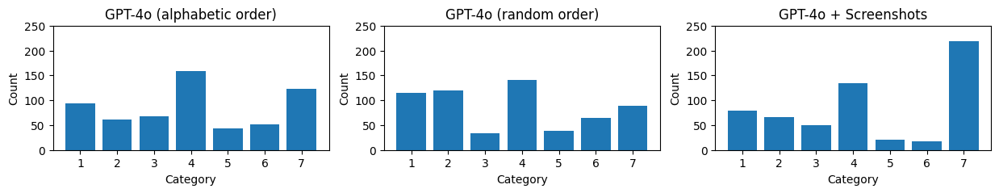

In [7]:
categorizations = [
    from_gpt4_1,
    from_gpt4_2,
    from_screenshots,
]

labels = [
    "GPT-4o (alphabetic order)",
    "GPT-4o (random order)",
    "GPT-4o + Screenshots",
]

fig, axs = plt.subplots(1, 3, figsize=(15, 2))
for i, categorization in enumerate(categorizations):
    categories = {}
    for category in categorization.values():
        if category in categories:
            categories[category] += 1
        else:
            categories[category] = 1
    axs[i].bar(categories.keys(), categories.values())
    axs[i].set_title(labels[i])
    axs[i].set_xlabel("Category")
    axs[i].set_ylabel("Count")
    axs[i].set_ylim(0, 250)

    
plt.show()

In [8]:
# randomly sample 8 websites from each category in from_screenshots

import random

for category in range(1, 8):
    websites = [website for website, cat in from_screenshots.items() if cat == category]
    random.shuffle(websites)
    print(f"Category {category}:")
    for website in websites[:8]:
        print(f"    {website}")
    print()
    

Category 1:
    www.trendyol.com
    www.aliexpress.com
    www.mercadolibre.com.ar
    www.amazon.com.br
    www.kleinanzeigen.de
    www.nike.com
    www.subito.it
    www.amazon.eg

Category 2:
    it.m.wikipedia.org
    www.sciencedirect.com
    context.reverso.net
    byjus.com
    ru.m.wikipedia.org
    tenki.jp
    zh.m.wikipedia.org
    www.wowhead.com

Category 3:
    business.facebook.com
    finance.naver.com
    www.coingecko.com
    unifiedportal-mem.epfindia.gov.in
    www.zillow.com
    one.google.com
    business.google.com
    onedrive.live.com

Category 4:
    www.nikkansports.com
    www.terra.com.br
    www.index.hr
    finance.yahoo.co.jp
    dzen.ru
    baseball.yahoo.co.jp
    www.elmundo.es
    www.ynet.co.il

Category 5:
    web.whatsapp.com
    www.pinterest.com
    www.reddit.com
    apps.facebook.com
    m.cafe.daum.net
    mpokec.azet.sk
    m.facebook.com
    in.pinterest.com

Category 6:
    www.bilibili.com
    www.jiocinema.com
    aniwatchtv.to
    www

In [113]:
def count_images_in_strata(all_images, category_dict, min_size=0, min_w=0, min_h=0):
    strata_counts = defaultdict(int)
    
    # for image_path, size, (w, h) in all_images:
    for domain in 
    
        domain = extract_domain(image_path)
        # print(domain)
        category = category_dict.get(domain, 7)
        if size >= min_size and (w >= min_w and h >= min_h) or (h >= min_w and w >= min_h):
            strata_counts[category] += 1
    
    return dict(strata_counts)

strata_counts = count_images_in_strata(all_images, from_screenshots, 0, 512, 256)
strata_counts

{1: 64, 3: 49, 7: 194, 2: 52, 4: 64, 5: 37, 6: 30}

In [119]:
def create_stratified_dataset(all_images, output_dir, num_samples_per_category, category_dict, min_size=0, min_w=0, min_h=0):
    original_target_dir = output_dir
    counter = 1
    while os.path.exists(output_dir):
        output_dir = f"{original_target_dir}_{counter}"
        counter += 1

    category_assignment = defaultdict(lambda: 7, category_dict)
    category_dirs = []

    strata_counts = count_images_in_strata(all_images, category_dict, min_size, min_w, min_h)
    
    for category_num in range(1, 8):
        category_dir = os.path.join(output_dir, f"category_{category_num}")
        
        category_images = [(image_path, size, dimensions) for image_path, size, dimensions in all_images
                           if category_assignment[extract_domain(image_path)] == category_num]
        
        num_samples = min(strata_counts[category_num], num_samples_per_category)
        
        target = sample_images_randomly_by_domain(category_images, category_dir, num_samples, min_size, min_w, min_h)
        category_dirs.append(target)

    return category_dirs

In [137]:
targets = create_stratified_dataset(all_images, "JUN21_stratified512x256_forstudy", 1, from_screenshots, 0, 512, 512)

Copying and renaming images: 100%|██████████| 1/1 [00:00<00:00, 1336.19image/s]


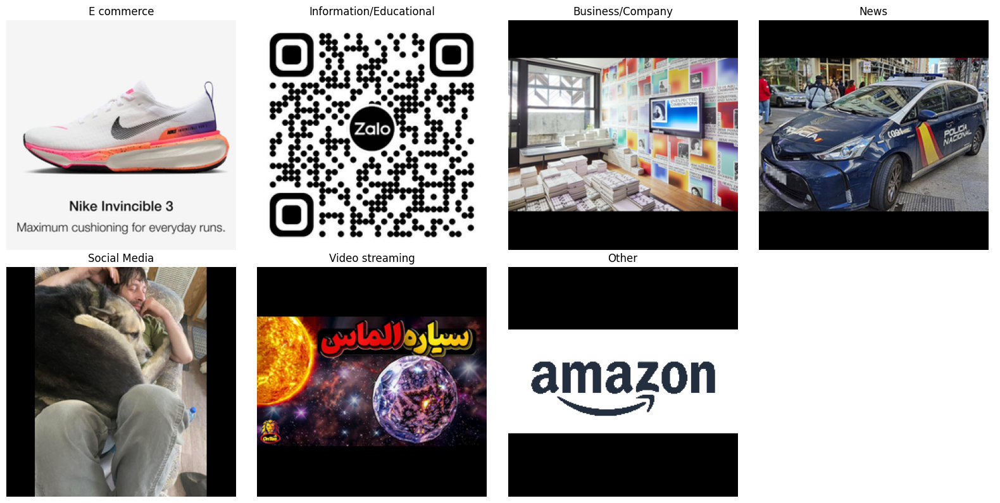

In [138]:
labels = [
    "E commerce",
    "Information/Educational",
    "Business/Company",
    "News",
    "Social Media",
    "Video streaming",
    "Other",
]

fig, axs = plt.subplots(2, 4, figsize=(16, 8))
axs = axs.flatten()

for idx, (t, label) in enumerate(zip(targets, labels)):
    collage_image = create_collage(t, None, 10, 250)
    axs[idx].imshow(collage_image)
    axs[idx].set_title(label)
    axs[idx].axis('off')

if len(targets) < len(axs):
    for ax in axs[len(targets):]:
        ax.axis('off')

plt.tight_layout()
plt.show()

In [267]:
new_sizes_d32 = [1 - ((image[2][0]/32)*(image[2][1]/32)*3)/image[1] for image in all_images]
new_sizes_d16 = [1 - ((image[2][0]/16)*(image[2][1]/16)*3)/image[1] for image in all_images]
new_sizes_32 = [1 - 32/image[1] for image in all_images]

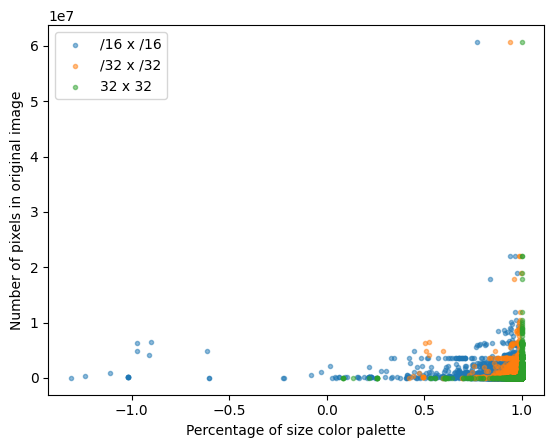

In [274]:
plt.scatter(new_sizes_d16, [image[2][0]*image[2][1] for image in all_images], marker='.', alpha=0.5, label='/16 x /16')
plt.scatter(new_sizes_d32, [image[2][0]*image[2][1] for image in all_images], marker='.', alpha=0.5, label='/32 x /32')
plt.scatter(new_sizes_32, [image[2][0]*image[2][1] for image in all_images], marker='.', alpha=0.5, label='32 x 32')
plt.xlabel("Percentage of size color palette")
plt.ylabel("Number of pixels in original image")
plt.legend()
plt.show()

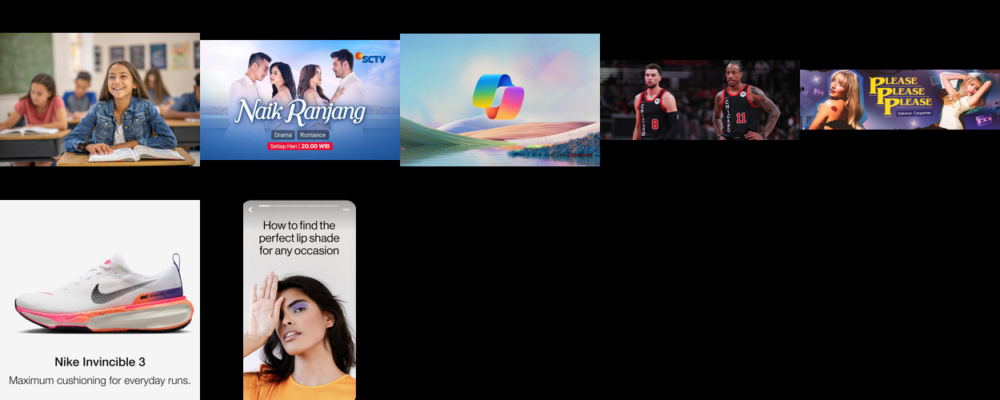

In [139]:
create_collage('jun21_salient')